# Array measurements ROBAT 226.238:
- 5 mic array adafruit 5 i2s 
- 48khz 
- 1.5 meters distance (~ far field = 10𝛌; 𝛌max = fmin; 343/2 = 171 Hz --> 10𝛌 = 1715 Hz; at 1000Hz: 4.5𝛌 = 4.5*0.343 = 1.5435 m)
- measured clockwise (R: 0-180; L: 180-360)
- array rotated around the central mic kept a 1.5m from source

**HW settings:**
- Harman kandon AWR 445 vol = -25 db (front: 270 to 90)
- Harman kandon AWR 445 vol = -5 db (back: 100 to 260)
- fireface analog out 1/2 stereo vol = 0db
- tweeter #1
- Ref mic: gras +30 db fireface channel 9, +20db channel A power module

**NOTE:**


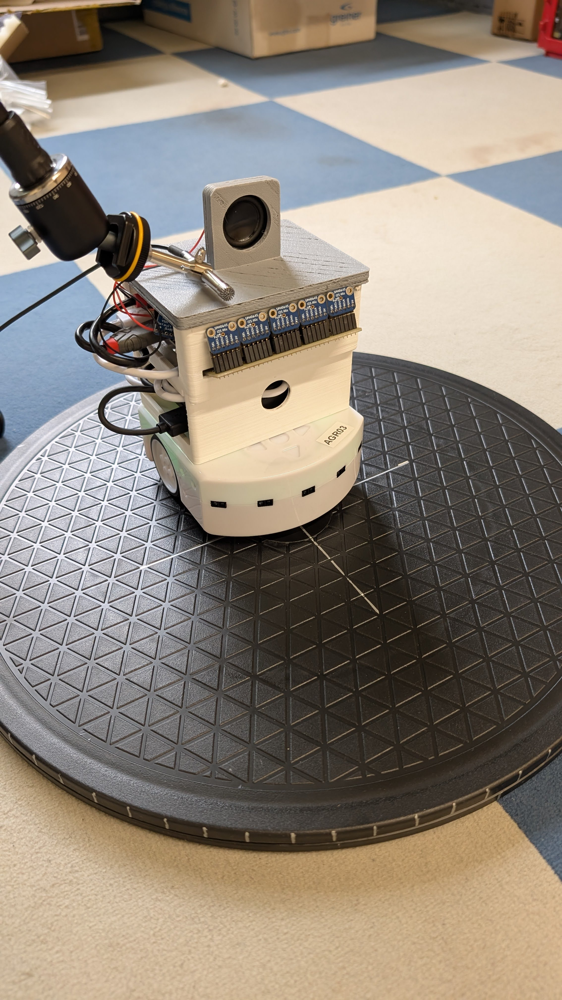

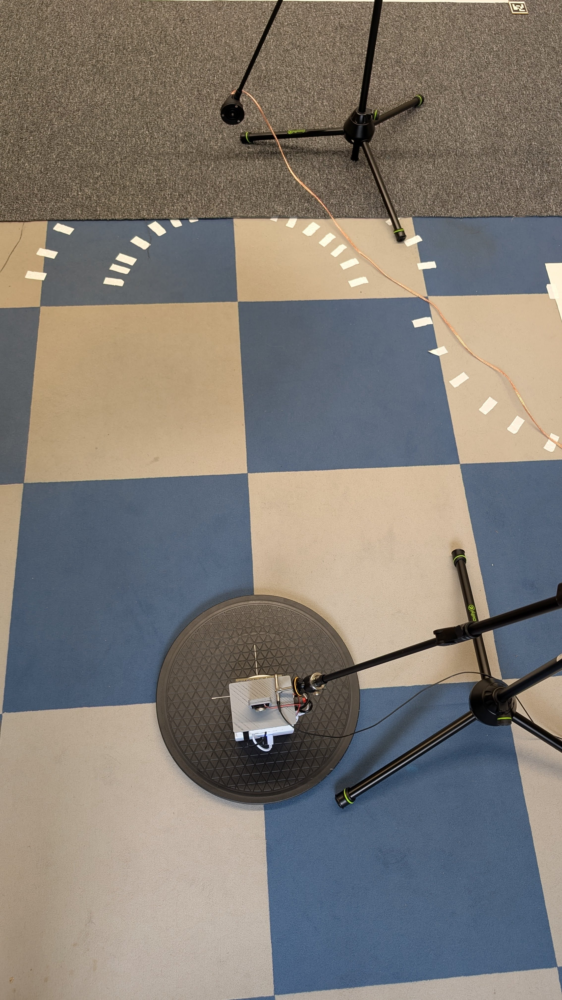

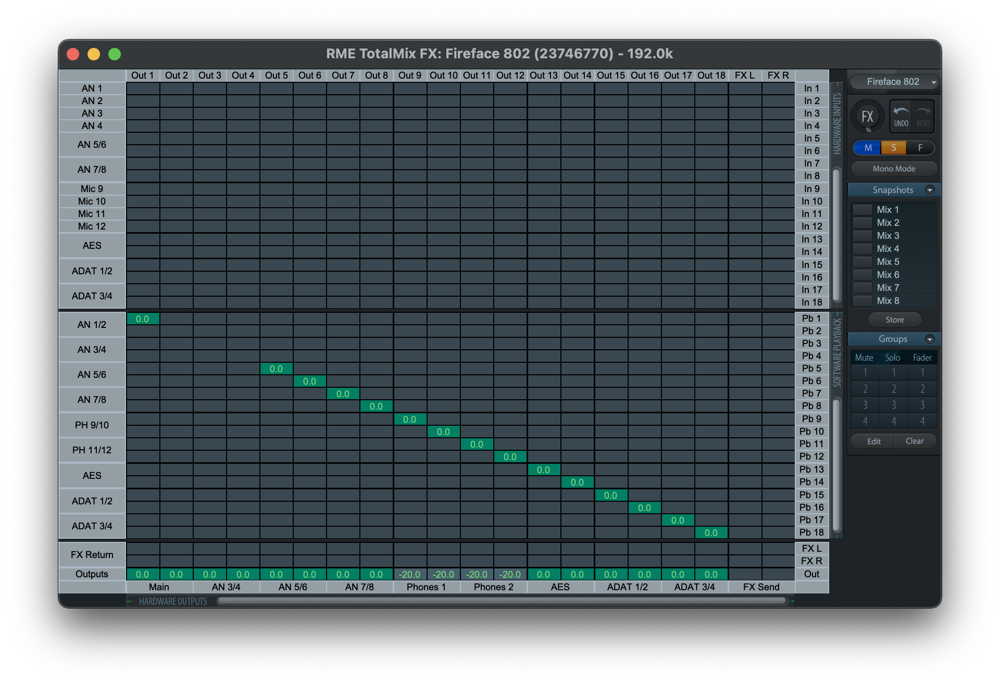

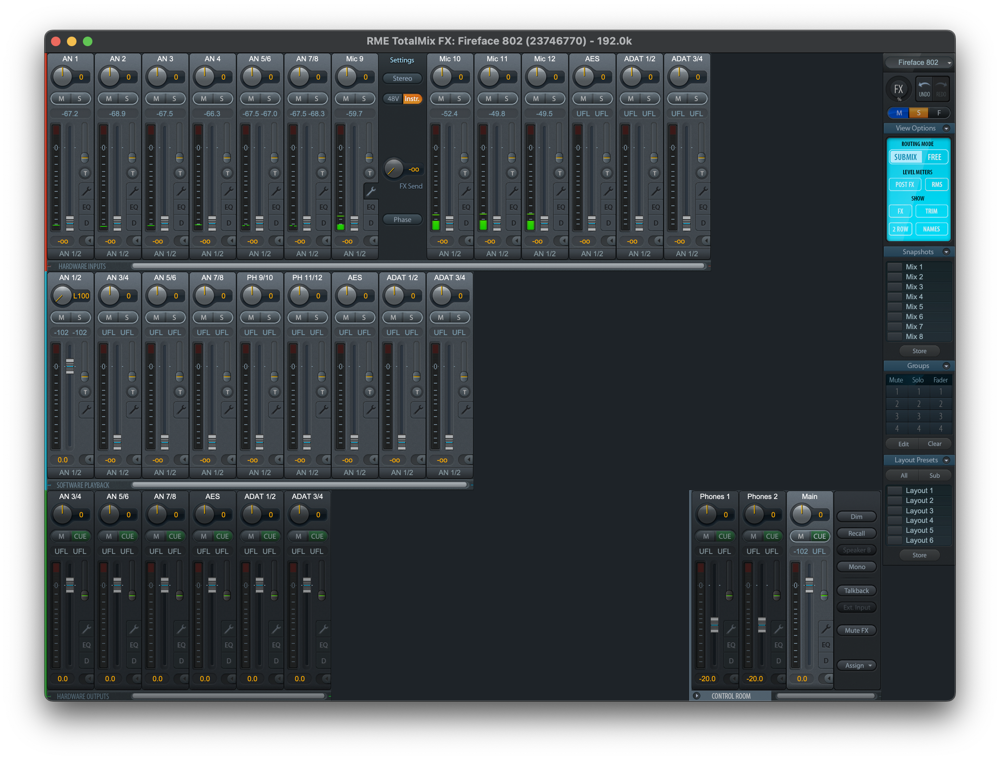

In [1]:
from IPython.display import Image
from IPython.display import display

display(
    Image(filename="./PXL_20250509_10061094.jpg", width=300),
    Image(filename="./PXL_20250509_10062195.jpg", width=300),
    Image(filename="./rme802_matrix.png", width=700),
    Image(filename="./rme802_mixer.png", width=700)
)

# Output signal
Out signal used during the recordings: 1-40Khz 5ms sweep.

/home/alberto/miniconda3/envs/robat2/lib/python3.11/site-packages/matplotlib/axes/_axes.py:7947: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


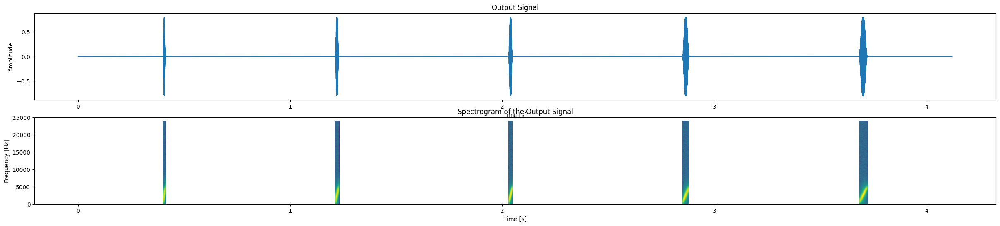

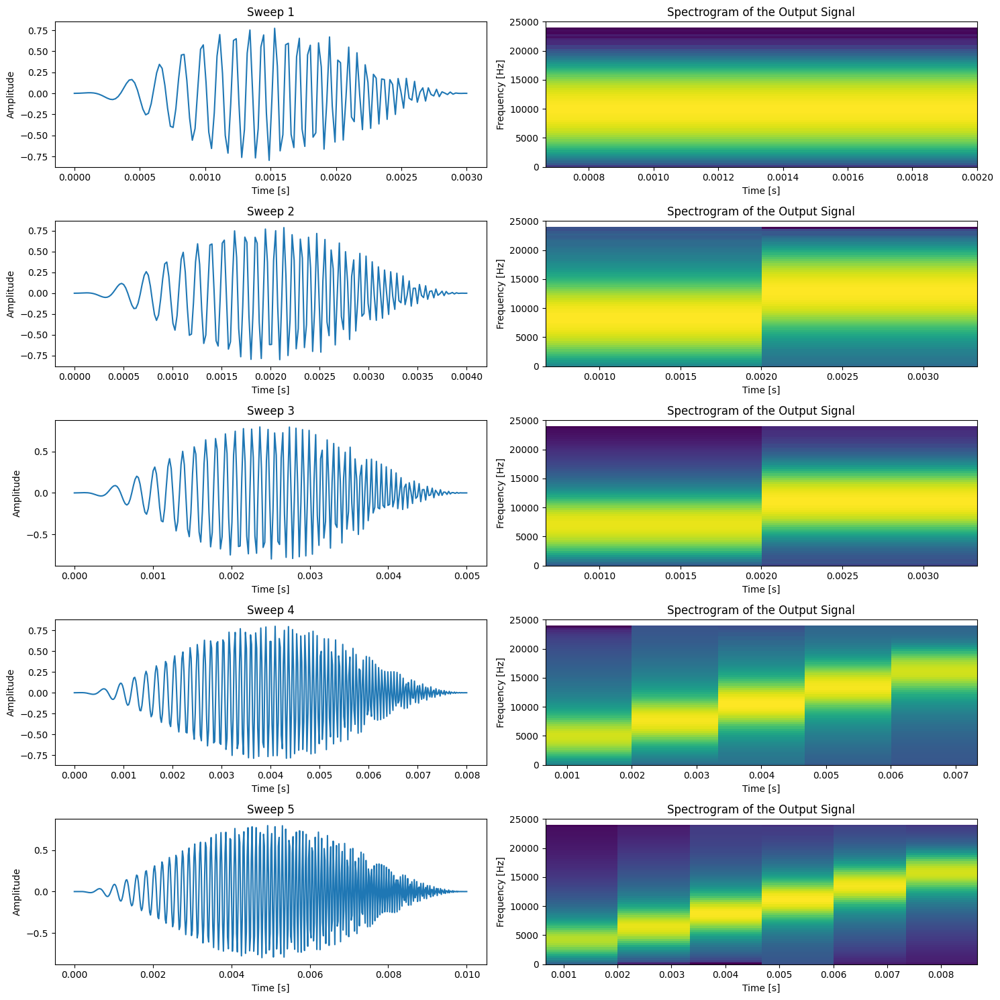

In [2]:
import scipy.signal as signal 
import numpy as np 
import matplotlib.pyplot as plt 
import sounddevice as sd
import soundfile as sf

#%%
# make a sweep
durns = np.array([3, 4, 5, 8, 10] )*1e-3
fs = 48000 # Hz

chirp = []
all_sweeps = []
for durn in durns:
    t = np.linspace(0, durn, int(fs*durn))
    start_f, end_f = 1e3, 20e3
    sweep = signal.chirp(t, start_f, t[-1], end_f)
    sweep *= signal.windows.tukey(sweep.size, 0.95)
    sweep *= 0.8
    sweep_padded = np.pad(sweep, pad_width=[int(fs*0.1)]*2, constant_values=[0,0])
    all_sweeps.append(sweep_padded)
    chirp.append(sweep)
    

sweeps_combined = np.concatenate(all_sweeps)

# Read the saved WAV file
out_signal, _ = sf.read('1_20k_5sweeps.wav')

# Plot the time-domain signal and spectrogram
plt.figure(figsize=(30, 6))

# Time-domain plot
plt.subplot(2, 1, 1)
plt.plot(np.linspace(0, len(out_signal) / fs, len(out_signal)), out_signal)
plt.title('Output Signal')
plt.xlabel('Time [s]')
plt.ylabel('Amplitude')

# Spectrogram plot
plt.subplot(2, 1, 2, sharex=plt.gca())
plt.specgram(out_signal, Fs=fs, NFFT=512, noverlap=256, cmap='viridis')
plt.title('Spectrogram of the Output Signal')
plt.xlabel('Time [s]')
plt.ylabel('Frequency [Hz]')
plt.ylim(0, 25e3)

# plot the chirp
plt.figure(figsize=(15, 15))
for i, sweep in enumerate(chirp):
    plt.subplot(len(chirp), 2, 2 * i + 1)
    plt.plot(np.linspace(0, len(sweep) / fs, len(sweep)), sweep)
    plt.title(f'Sweep {i+1}')
    plt.xlabel('Time [s]')
    plt.ylabel('Amplitude')
    # Spectrogram plot

    plt.subplot(len(chirp), 2, 2 * i + 2)
    plt.specgram(sweep, Fs=fs, NFFT=128, noverlap=64, cmap='viridis')
    plt.title('Spectrogram of the Output Signal')
    plt.xlabel('Time [s]')
    plt.ylabel('Frequency [Hz]')
    plt.ylim(0, 25e3)

plt.tight_layout()
plt.show()


# Analysis

1. Angular audiofile import and extraction from multiwav to single channel recordings


In [3]:
# %% Libraries and files
import os
import soundfile as sf

# Load audio files, then plot a 6x6 grid
DIR = "./2025-05-09/original/"  # Directory containing the audio files
audio_files = os.listdir(DIR)  # List all files in the sweeps directory
audio_files.sort()  # Sort the files in ascending order

# Directory to save the extracted channels
output_dir = "./2025-05-09/extracted_channels/"
os.makedirs(output_dir, exist_ok=True)  # Create the directory if it doesn't exist

# Path to the multi-channel WAV file
for file in audio_files:
    file_path = os.path.join(DIR, file)

    angle_name = file.split('.')[0]
    print(f"Processing file: {angle_name}")

    # Read the multi-channel WAV file
    audio_data, sample_rate = sf.read(DIR + file)

    # Check the shape of the audio data
    print(f"Audio data shape: {audio_data.shape}")  # (samples, channels)

    # Extract individual channels
    num_channels = audio_data.shape[1]  # Number of channels
    channels = [audio_data[:, i] for i in range(num_channels)]

    # Save each channel as a separate WAV file
    for i, channel_data in enumerate(channels):
        output_file = os.path.join(output_dir, angle_name+f"_{i + 1}.wav")  # Path to the output file
        sf.write(output_file, channel_data, sample_rate)
        print(f"Saved channel {i + 1} to {output_file}")


Processing file: 000
Audio data shape: (454134, 5)
Saved channel 1 to ./2025-05-09/extracted_channels/000_1.wav
Saved channel 2 to ./2025-05-09/extracted_channels/000_2.wav
Saved channel 3 to ./2025-05-09/extracted_channels/000_3.wav
Saved channel 4 to ./2025-05-09/extracted_channels/000_4.wav
Saved channel 5 to ./2025-05-09/extracted_channels/000_5.wav
Processing file: 010
Audio data shape: (380350, 5)
Saved channel 1 to ./2025-05-09/extracted_channels/010_1.wav
Saved channel 2 to ./2025-05-09/extracted_channels/010_2.wav
Saved channel 3 to ./2025-05-09/extracted_channels/010_3.wav
Saved channel 4 to ./2025-05-09/extracted_channels/010_4.wav
Saved channel 5 to ./2025-05-09/extracted_channels/010_5.wav
Processing file: 020
Audio data shape: (419955, 5)
Saved channel 1 to ./2025-05-09/extracted_channels/020_1.wav
Saved channel 2 to ./2025-05-09/extracted_channels/020_2.wav
Saved channel 3 to ./2025-05-09/extracted_channels/020_3.wav
Saved channel 4 to ./2025-05-09/extracted_channels/020

2. Sorting of the angular extracted files into the separate channels

In [4]:
# List all extracted channel files separated by channel number
from natsort import natsorted

# Directory containing the extracted channels
extracted_channels_dir = output_dir

# List all extracted channel files
channel_files = os.listdir(extracted_channels_dir)

# Filter out directories and non-audio files, keep only valid files
channel_files = [f for f in channel_files if os.path.isfile(os.path.join(extracted_channels_dir, f)) and f.endswith('.wav')]

# Sort the files naturally by the last part of their names (e.g., channel number)
sorted_channel_files = natsorted(channel_files, key=lambda x: int(x.split('_')[-1].split('.')[0]))

# Group files by the last part of their name (channel number)
grouped_files = {}

for file in sorted_channel_files:
    # Extract the channel number from the file name (e.g., "350_1.wav" -> "1")
    channel_number = int(file.split('_')[-1].split('.')[0])

    # Group files by channel number
    if channel_number not in grouped_files:
        grouped_files[channel_number] = []
    grouped_files[channel_number].append(file)

for i in range(len(grouped_files)):
    grouped_files[i+1].sort()

# Print grouped files
for channel_number, files in grouped_files.items():
    print(f"Channel {channel_number}:")
    for f in files:
        print(f"  {f}")


Channel 1:
  000_1.wav
  010_1.wav
  020_1.wav
  030_1.wav
  040_1.wav
  050_1.wav
  060_1.wav
  070_1.wav
  080_1.wav
  090_1.wav
  100_1.wav
  110_1.wav
  120_1.wav
  130_1.wav
  140_1.wav
  150_1.wav
  160_1.wav
  170_1.wav
  180_1.wav
  190_1.wav
  200_1.wav
  210_1.wav
  220_1.wav
  230_1.wav
  240_1.wav
  250_1.wav
  260_1.wav
  270_1.wav
  280_1.wav
  290_1.wav
  300_1.wav
  310_1.wav
  320_1.wav
  330_1.wav
  340_1.wav
  350_1.wav
  360_1.wav
Channel 2:
  000_2.wav
  010_2.wav
  020_2.wav
  030_2.wav
  040_2.wav
  050_2.wav
  060_2.wav
  070_2.wav
  080_2.wav
  090_2.wav
  100_2.wav
  110_2.wav
  120_2.wav
  130_2.wav
  140_2.wav
  150_2.wav
  160_2.wav
  170_2.wav
  180_2.wav
  190_2.wav
  200_2.wav
  210_2.wav
  220_2.wav
  230_2.wav
  240_2.wav
  250_2.wav
  260_2.wav
  270_2.wav
  280_2.wav
  290_2.wav
  300_2.wav
  310_2.wav
  320_2.wav
  330_2.wav
  340_2.wav
  350_2.wav
  360_2.wav
Channel 3:
  000_3.wav
  010_3.wav
  020_3.wav
  030_3.wav
  040_3.wav
  050_3.wav
  060_3

3. Matched filtering:
 - Every file is matched with the output
 - First sweep is extracted and displayed
 - Detected sweeps over a threshold value set in the peakfinding to avoid misvalues
 - First sweep is saved to a new directory to be analyzed 
 - avarage RMS of all the sweep in every recording is saved

Processing Channel 1:
Peaks detected in 000_1.wav: 5
RMS value of sweep at peak 4.334145833333333 sec in 000_1.wav: 0.16475
RMS value of sweep at peak 4.537604166666667 sec in 000_1.wav: 0.16427
RMS value of sweep at peak 4.742166666666667 sec in 000_1.wav: 0.16320
RMS value of sweep at peak 4.948479166666667 sec in 000_1.wav: 0.15664
RMS value of sweep at peak 5.157354166666667 sec in 000_1.wav: 0.15046
Peaks detected in 010_1.wav: 5
RMS value of sweep at peak 2.5980625 sec in 010_1.wav: 0.17118
RMS value of sweep at peak 2.8015416666666666 sec in 010_1.wav: 0.17065
RMS value of sweep at peak 3.0059375 sec in 010_1.wav: 0.17030
RMS value of sweep at peak 3.2125 sec in 010_1.wav: 0.16331
RMS value of sweep at peak 3.4213125 sec in 010_1.wav: 0.16014
Peaks detected in 020_1.wav: 5
RMS value of sweep at peak 2.71475 sec in 020_1.wav: 0.18039
RMS value of sweep at peak 2.91825 sec in 020_1.wav: 0.18029
RMS value of sweep at peak 3.1226666666666665 sec in 020_1.wav: 0.18195
RMS value of sw

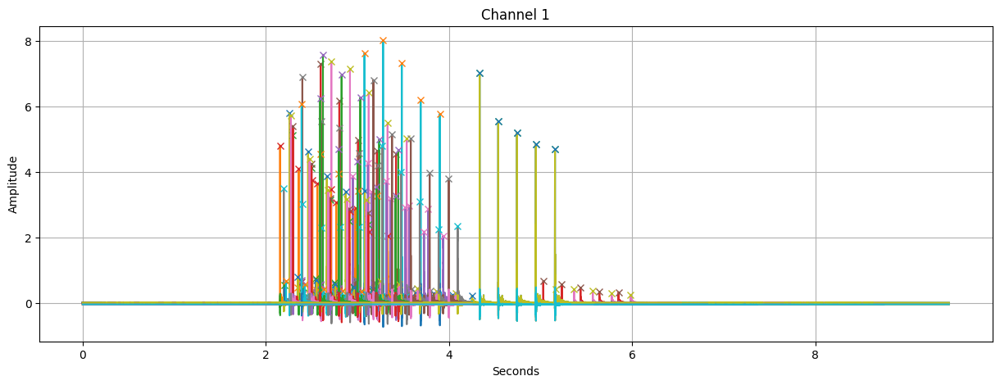

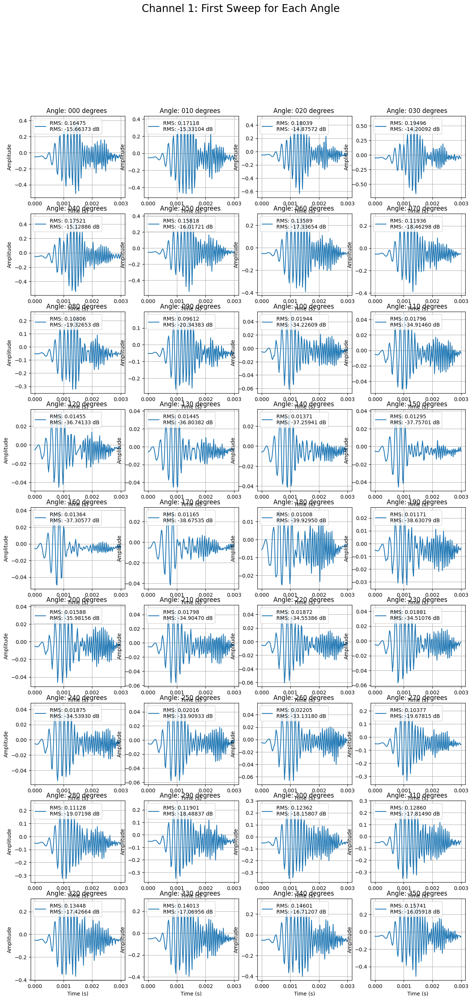

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Processing Channel 2:
Peaks detected in 000_2.wav: 5
RMS value of sweep at peak 4.334145833333333 sec in 000_2.wav: 0.20345
RMS value of sweep at peak 4.537625 sec in 000_2.wav: 0.20346
RMS value of sweep at peak 4.742020833333333 sec in 000_2.wav: 0.20339
RMS value of sweep at peak 4.948270833333333 sec in 000_2.wav: 0.20050
RMS value of sweep at peak 5.1570625 sec in 000_2.wav: 0.19680
Peaks detected in 010_2.wav: 5
RMS value of sweep at peak 2.5980625 sec in 010_2.wav: 0.21888
RMS value of sweep at peak 2.8015416666666666 sec in 010_2.wav: 0.21788
RMS value of sweep at peak 3.0059375 sec in 010_2.wav: 0.21764
RMS value of sweep at peak 3.2121666666666666 sec in 010_2.wav: 0.21469
RMS value of sweep at peak 3.421 sec in 010_2.wav: 0.21200
Peaks detected in 020_2.wav: 5
RMS value of sweep at peak 2.714729166666667 sec in 020_2.wav: 0.21136
RMS value of sweep at peak 2.918229166666667 sec in 020_2.wav: 0.21262
RMS value of sweep at peak 3.122625 sec in 020_2.wav: 0.21412
RMS value of s

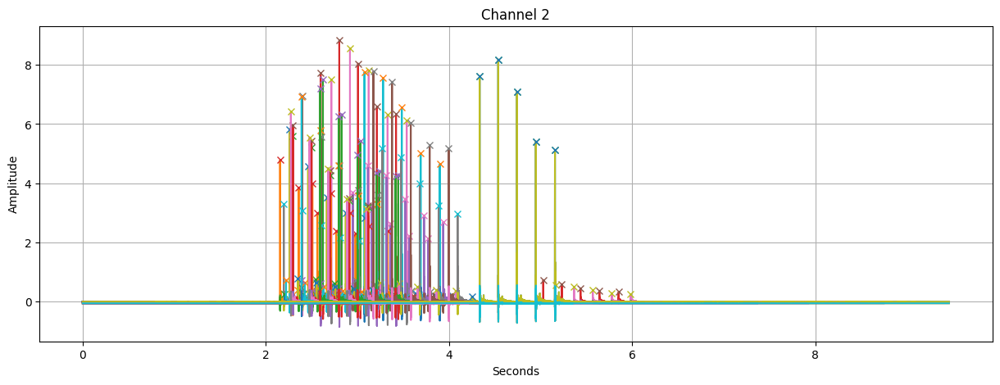

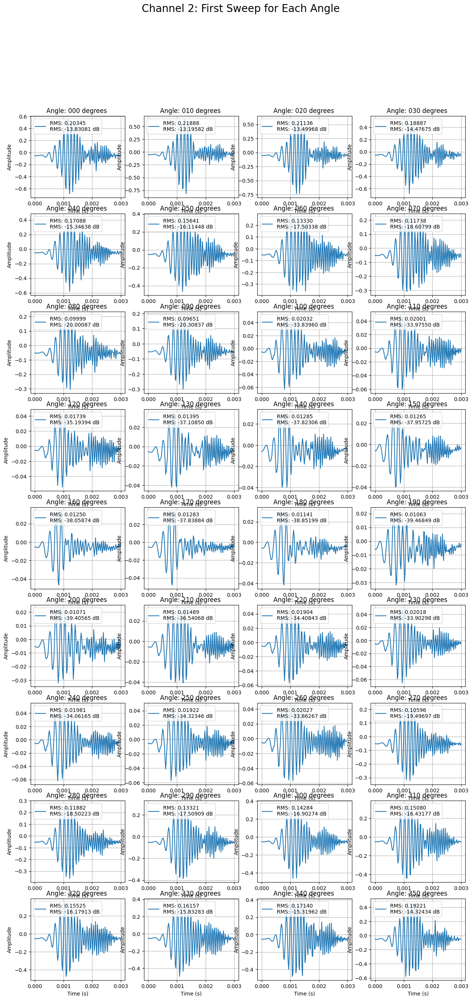

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Processing Channel 3:
Peaks detected in 000_3.wav: 5
RMS value of sweep at peak 4.334145833333333 sec in 000_3.wav: 0.19745
RMS value of sweep at peak 4.537625 sec in 000_3.wav: 0.19755
RMS value of sweep at peak 4.742020833333333 sec in 000_3.wav: 0.19740
RMS value of sweep at peak 4.948104166666667 sec in 000_3.wav: 0.19545
RMS value of sweep at peak 5.157041666666666 sec in 000_3.wav: 0.19127
Peaks detected in 010_3.wav: 5
RMS value of sweep at peak 2.5980416666666666 sec in 010_3.wav: 0.19057
RMS value of sweep at peak 2.8015208333333335 sec in 010_3.wav: 0.19006
RMS value of sweep at peak 3.005895833333333 sec in 010_3.wav: 0.18958
RMS value of sweep at peak 3.2122916666666668 sec in 010_3.wav: 0.18526
RMS value of sweep at peak 3.421104166666667 sec in 010_3.wav: 0.17870
Peaks detected in 020_3.wav: 5
RMS value of sweep at peak 2.7147083333333333 sec in 020_3.wav: 0.18227
RMS value of sweep at peak 2.9181875 sec in 020_3.wav: 0.18296
RMS value of sweep at peak 3.1225625 sec in 02

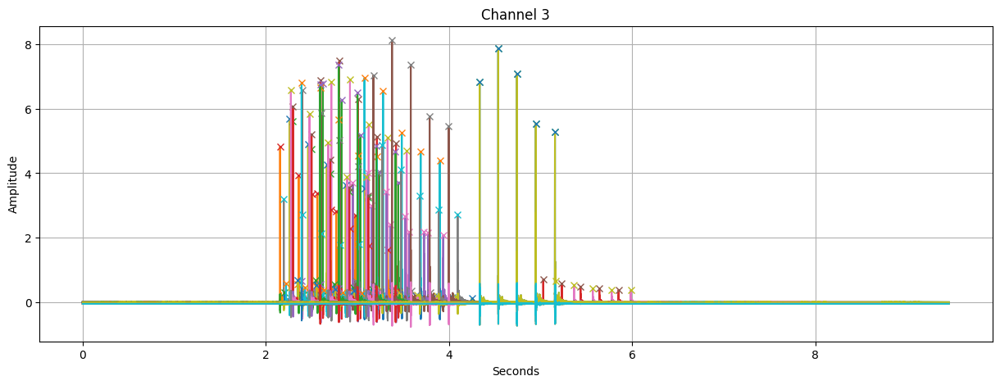

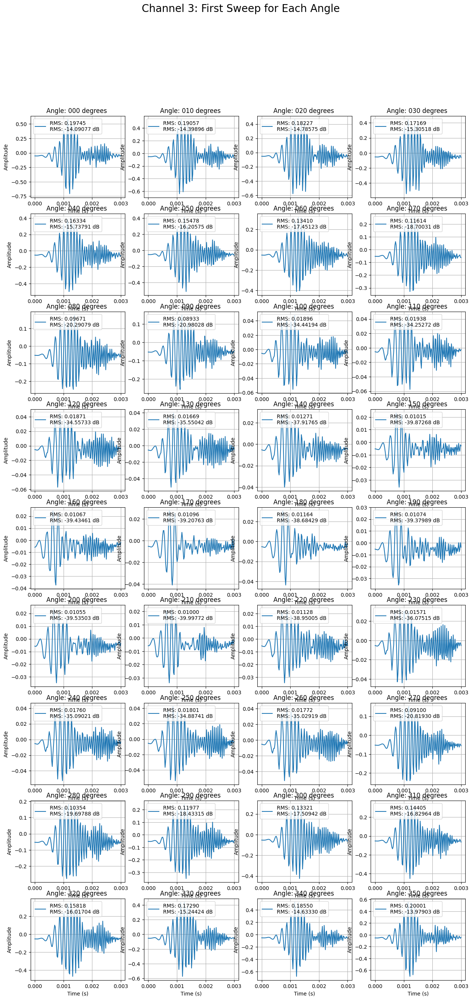

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Processing Channel 4:
Peaks detected in 000_4.wav: 5
RMS value of sweep at peak 4.334145833333333 sec in 000_4.wav: 0.18892
RMS value of sweep at peak 4.537604166666667 sec in 000_4.wav: 0.18889
RMS value of sweep at peak 4.7421875 sec in 000_4.wav: 0.18808
RMS value of sweep at peak 4.9485 sec in 000_4.wav: 0.17874
RMS value of sweep at peak 5.157354166666667 sec in 000_4.wav: 0.16978
Peaks detected in 010_4.wav: 5
RMS value of sweep at peak 2.5980416666666666 sec in 010_4.wav: 0.17750
RMS value of sweep at peak 2.8014791666666667 sec in 010_4.wav: 0.17800
RMS value of sweep at peak 3.0060625 sec in 010_4.wav: 0.17720
RMS value of sweep at peak 3.2123541666666666 sec in 010_4.wav: 0.16919
RMS value of sweep at peak 3.4212083333333334 sec in 010_4.wav: 0.15868
Peaks detected in 020_4.wav: 5
RMS value of sweep at peak 2.7146875 sec in 020_4.wav: 0.17072
RMS value of sweep at peak 2.9181458333333334 sec in 020_4.wav: 0.17144
RMS value of sweep at peak 3.1225 sec in 020_4.wav: 0.17123
RMS

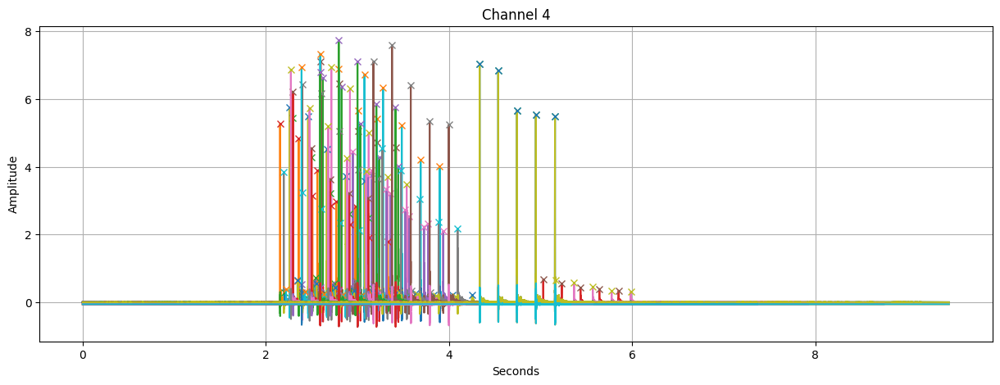

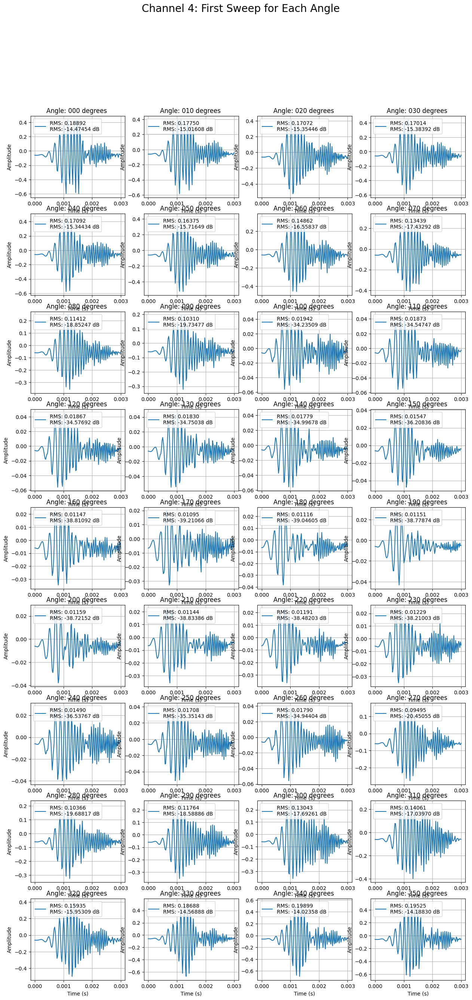

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Processing Channel 5:
Peaks detected in 000_5.wav: 5
RMS value of sweep at peak 4.334145833333333 sec in 000_5.wav: 0.16057
RMS value of sweep at peak 4.5375625 sec in 000_5.wav: 0.16109
RMS value of sweep at peak 4.741916666666667 sec in 000_5.wav: 0.16093
RMS value of sweep at peak 4.9485625 sec in 000_5.wav: 0.14445
RMS value of sweep at peak 5.157375 sec in 000_5.wav: 0.13540
Peaks detected in 010_5.wav: 5
RMS value of sweep at peak 2.5980208333333334 sec in 010_5.wav: 0.15782
RMS value of sweep at peak 2.801458333333333 sec in 010_5.wav: 0.15845
RMS value of sweep at peak 3.0057916666666666 sec in 010_5.wav: 0.15841
RMS value of sweep at peak 3.2125208333333335 sec in 010_5.wav: 0.13935
RMS value of sweep at peak 3.4215416666666667 sec in 010_5.wav: 0.12874
Peaks detected in 020_5.wav: 5
RMS value of sweep at peak 2.7146666666666666 sec in 020_5.wav: 0.15814
RMS value of sweep at peak 2.9181041666666667 sec in 020_5.wav: 0.15883
RMS value of sweep at peak 3.1224375 sec in 020_5.wa

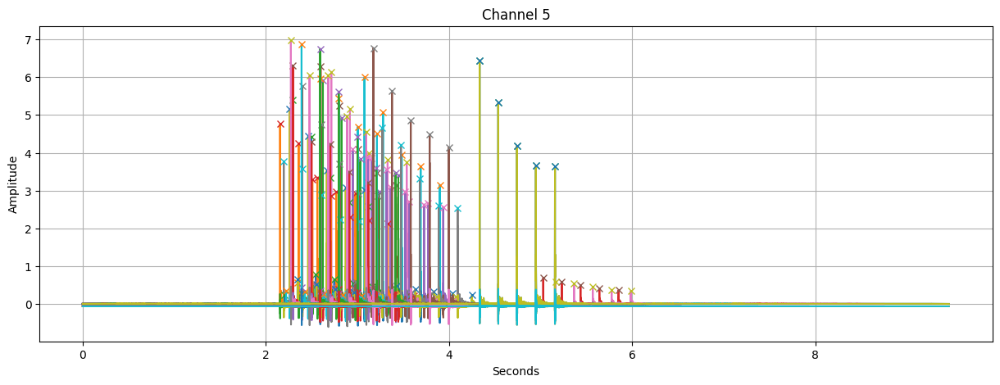

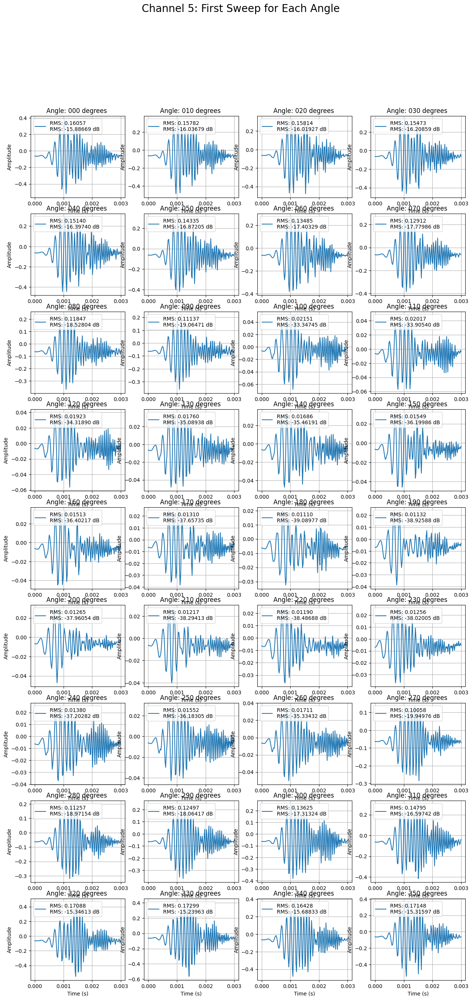

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.



RMS Values for All Files:
000_1.wav: 0.15046
010_1.wav: 0.16014
020_1.wav: 0.17951
030_1.wav: 0.18979
040_1.wav: 0.16510
050_1.wav: 0.14863
060_1.wav: 0.12735
070_1.wav: 0.11317
080_1.wav: 0.10198
090_1.wav: 0.08756
100_1.wav: 0.01701
110_1.wav: 0.01478
120_1.wav: 0.01297
130_1.wav: 0.01261
140_1.wav: 0.01147
150_1.wav: 0.01118
160_1.wav: 0.01183
170_1.wav: 0.01040
180_1.wav: 0.00757
190_1.wav: 0.01014
200_1.wav: 0.01358
210_1.wav: 0.01526
220_1.wav: 0.01439
230_1.wav: 0.01484
240_1.wav: 0.01517
250_1.wav: 0.01681
260_1.wav: 0.01851
270_1.wav: 0.10171
280_1.wav: 0.09637
290_1.wav: 0.10343
300_1.wav: 0.10931
310_1.wav: 0.11664
320_1.wav: 0.12209
330_1.wav: 0.12596
340_1.wav: 0.13108
350_1.wav: 0.14367
360_1.wav: 0.15046
000_2.wav: 0.19680
010_2.wav: 0.21200
020_2.wav: 0.20799
030_2.wav: 0.18566
040_2.wav: 0.16460
050_2.wav: 0.15166
060_2.wav: 0.12622
070_2.wav: 0.11355
080_2.wav: 0.09845
090_2.wav: 0.09308
100_2.wav: 0.01553
110_2.wav: 0.01537
120_2.wav: 0.01560
130_2.wav: 0.01080
140_

In [51]:
import scipy
import scipy.stats

gain = 20  # dB

db_to_linear = lambda X: 10**(X/20)
dB = lambda X: 20 * np.log10(abs(np.array(X).flatten()))

# Define the matched filter function
def matched_filter(recording, chirp_template):
    filtered_output = np.roll(signal.correlate(recording, chirp_template, 'same', method='direct'), -len(chirp_template)//2)
    filtered_output *= signal.windows.tukey(filtered_output.size, 0.1)
    filtered_envelope = np.abs(signal.hilbert(filtered_output))
    #return filtered_output
    return filtered_envelope

# Detect peaks in the matched filter output
def detect_peaks(filtered_output):
    peaks, properties = signal.find_peaks(filtered_output, prominence=0.1, distance=0.2 * sample_rate)
    return peaks

# Process each channel
DIR_first_sweep = extracted_channels_dir + "first_sweep/"  # Directory to save the first sweeps
os.makedirs(DIR_first_sweep, exist_ok=True)  # Create the directory if it doesn't exist

# Dictionary to store RMS values for all files
rms_values_dict = {}

channel_number = 1
for i in range(len(grouped_files)):
    files = grouped_files[i+1]
    print(f"Processing Channel {channel_number}:")
    
    # Create a new figure for each channel
    fig, ax = plt.subplots(figsize=(15, 5))
    ax.set_title(f"Channel {channel_number}")
    ax.set_xlabel("Seconds")
    ax.set_ylabel("Amplitude")
    ax.grid(True)

    for file in files[0:len(files)]:
        file_path = os.path.join(extracted_channels_dir, file)
        recording, sample_rate = sf.read(file_path)

        angle_name = int(file.split('_')[0])

        if 100 <= angle_name <= 260:  
            
            recording *= db_to_linear(-gain)
            print('file',file, '\n',recording)

        # Apply matched filtering
        filtered_output = matched_filter(recording, chirp[0])
        
        ax.plot(np.linspace(0, len(filtered_output) / sample_rate, len(filtered_output)), filtered_output, label=f"Filtered Output - {file}")
        #ax.plot(np.linspace(0, len(filtered_envelope) / sample_rate, len(filtered_envelope)), filtered_envelope, label=f"Filtered env - {file}", color='orange')
        ax.plot(np.linspace(0, len(recording) / sample_rate, len(recording)), recording, label=f"rec - {file}")
        #ax.legend(loc='upper right')
        #ax.set_xlim(4.334, 4.338)
        #ax.set_xlim(4, 6)


        # Detect peaks
        peaks = detect_peaks(filtered_output)
        print(f"Peaks detected in {file}: {len(peaks)}")
        
        # Plot peaks on the filtered output
        ax.plot(peaks / sample_rate, filtered_output[peaks], "x", label="Detected Peaks")
        #ax.legend(loc='upper right')
        
        if len(peaks) > 0:
            # Extract the first sweep
            first_sweep_start = peaks[0] 
            first_sweep_end = first_sweep_start + len(chirp[0])
            first_sweep = recording[first_sweep_start:first_sweep_end]

            # Calculate RMS value of the first sweep
            rms_first_sweep = np.sqrt(np.mean(first_sweep**2))
            #print(f"RMS value of the first sweep in {file}: {rms_first_sweep:.5f}")

            # Store RMS value in the dictionary
            #rms_values_dict[file] = rms_first_sweep

            # Calculate RMS values for all detected peaks
            rms_values = []
            for idx_peak, peak in enumerate(peaks):

                sweep_start = peak 
                sweep_end = sweep_start + len(chirp[idx_peak]) 
                sweep = recording[sweep_start:sweep_end]
                rms = np.sqrt(np.mean(sweep**2))
                rms_values.append(rms)
                print(f"RMS value of sweep at peak {peak/sample_rate} sec in {file}: {rms:.5f}")
            
            # Calculate the average RMS value of all peaks
            average_rms = scipy.stats.mode(rms_values)
            average_rms = average_rms[0]
            rms_values_dict[file] = average_rms

            #print(f"Average RMS value of all sweeps in {file}: {average_rms:.5f}")

            sf.write(DIR_first_sweep + file, first_sweep, int(sample_rate))

        else:
            print(f"No sweeps detected in {file} - Channel {channel_number}")
        

    # Plot all angles, skipping '360'
    fig1, axs = plt.subplots(9, 4, figsize=(15, 30), sharey=False)
    angles = [file.split('_')[0] for file in files]  # Extract angle names from filenames

    idx_to_plot = 0
    for idx, file in enumerate(files):
        if angles[idx] == '360':
            continue  # Skip the 360 angle

        file_path = os.path.join(DIR_first_sweep, file)
        audio, sample_rate = sf.read(file_path)

        rms = np.sqrt(np.mean(audio**2))
        rms_db = 20 * np.log10(rms)
        
        row = idx_to_plot // 4
        col = idx_to_plot % 4
        
        ax = axs[row, col]
        ax.plot(np.linspace(0, len(audio) / sample_rate, len(audio)), audio)
        ax.set_title(f"Angle: {angles[idx]} degrees ")  # Use extracted angle name with units
        ax.set_xlabel("Time (s)")
        ax.set_ylabel("Amplitude")
        ax.grid(True)
        ax.legend([f'RMS: {rms:.5f}\nRMS: {rms_db:.5f} dB'], loc='upper left')

        idx_to_plot += 1

    plt.suptitle(f"Channel {channel_number}: First Sweep for Each Angle", fontsize=20)
    #plt.tight_layout(rect=[0, 0.03, 1, 0.95])  # Adjust layout to make room for suptitle
    plt.show(block = False)

    ax.legend()
    channel_number += 1

plt.show(block = False)

# Print the dictionary of RMS values
print("\nRMS Values for All Files:")
for file, rms_value in rms_values_dict.items():
    print(f"{file}: {rms_value:.5f}")

4. RMS values of the *whole file* is calculated and displayed in a polar plot

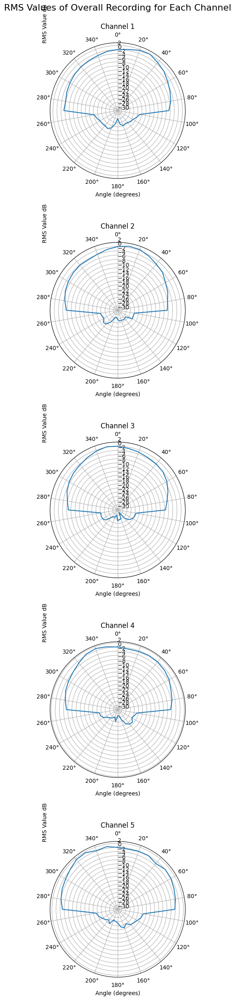

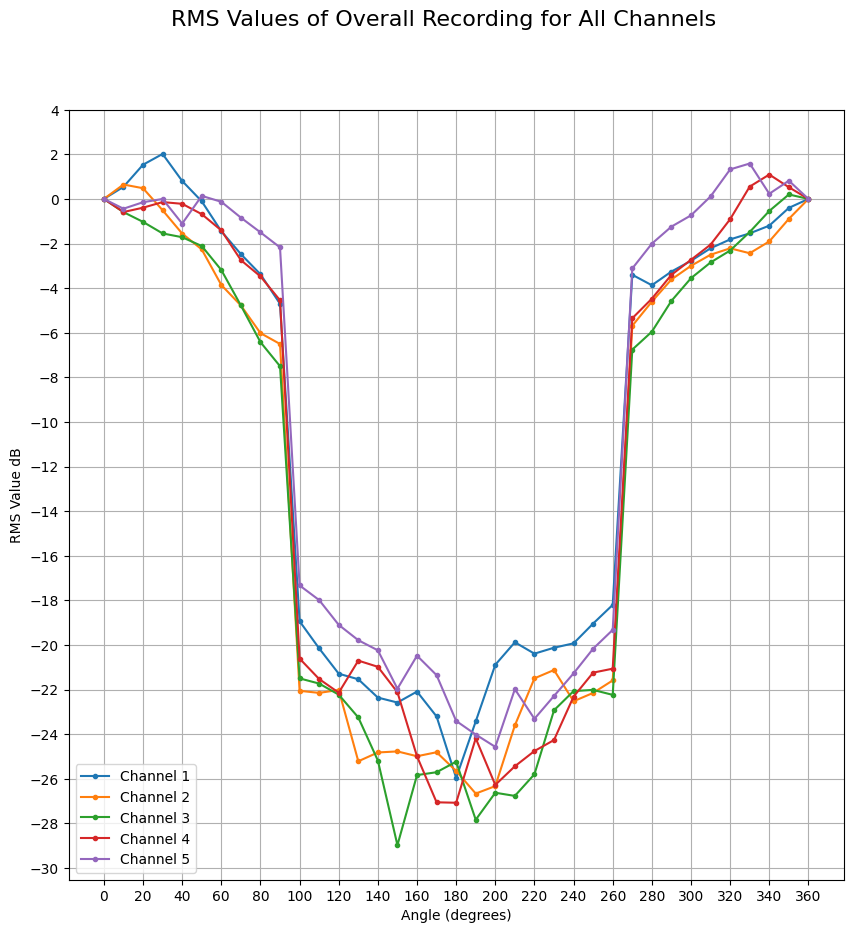

In [47]:
# RMS values of the overall recording for each channel and each angle

num_channels = len(grouped_files)
fig_polar, axs_polar = plt.subplots(num_channels, 1, figsize=( 5,25), subplot_kw={'projection': 'polar'})
fig_polar.suptitle("RMS Values of Overall Recording for Each Channel", fontsize=16)

fig_linear, ax_linear = plt.subplots(figsize=(10, 10))
fig_linear.suptitle("RMS Values of Overall Recording for All Channels", fontsize=16)

for i in range(num_channels):
    channel_number = i + 1
    files = grouped_files[channel_number]
    
    rms_values = []
    rms_values_norm_db = []
    angles = []
    
    for file in files:

        rms = rms_values_dict[file]
        
        rms_values.append(rms)

        rms_values_norm = rms_values / rms_values[0]
        rms_values_norm_db = 20 * np.log10(rms_values_norm)

        angle_name = file.split('_')[0]
        angles.append(int(angle_name))
    
    # Convert angles to radians
    angles_rad = np.radians(angles)
    
    # Plot RMS values in polar plot
    ax_polar = axs_polar[i] if num_channels > 1 else axs_polar
    ax_polar.plot(angles_rad, rms_values_norm_db, linestyle='-', label=f"Channel {channel_number}")
    ax_polar.set_title(f"Channel {channel_number}")
    ax_polar.set_theta_zero_location("N")  # Set 0 degrees to North
    ax_polar.set_theta_direction(-1)  # Set clockwise direction
    ax_polar.set_xticks(np.linspace(0, 2 * np.pi, 18, endpoint=False))  # Set angle ticks
    ax_polar.set_xlabel("Angle (degrees)")
    ax_polar.set_ylabel("RMS Value dB", position=(0, 1), ha='left')
    ax_polar.set_rlabel_position(0)
    ax_polar.set_yticks(np.arange(-30, 3, 2))  # Set y-ticks

    # Plot RMS values in linear plot
    ax_linear.plot(angles, rms_values_norm_db, marker='.', linestyle='-', label=f"Channel {channel_number}")
    ax_linear.set_xlabel("Angle (degrees)")
    ax_linear.set_xticks(np.linspace(0, 380, 19, endpoint=False))  # Set angle ticks
    ax_linear.set_ylabel("RMS Value dB")
    ax_linear.set_yticks(np.arange(-30, 5, 2))  # Set y-ticks
    ax_linear.legend()
    ax_linear.grid(True)

fig_polar.tight_layout()
plt.show(block = False)


5. Frequency analysis of every channel up to 40 KHz

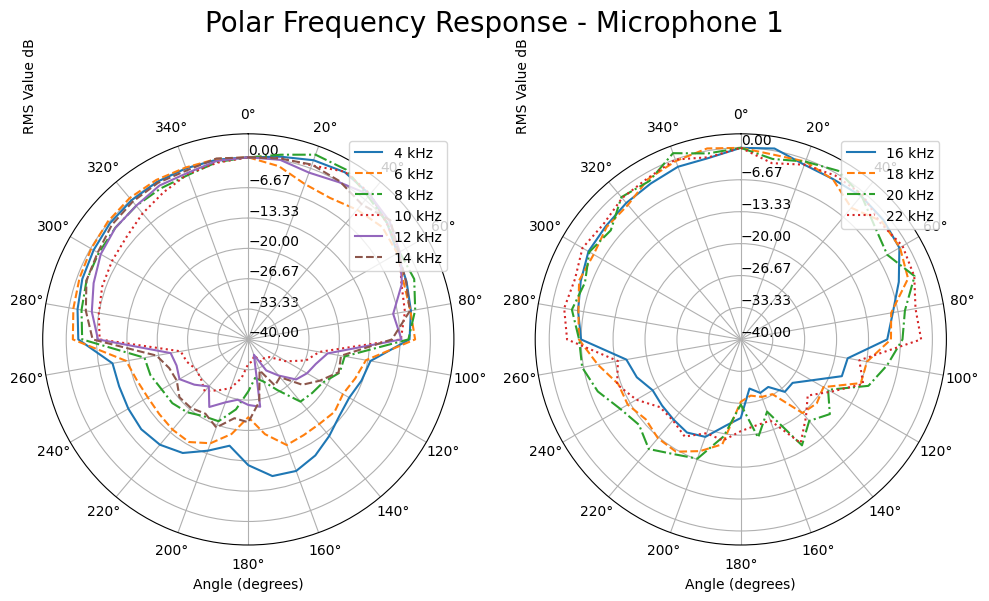

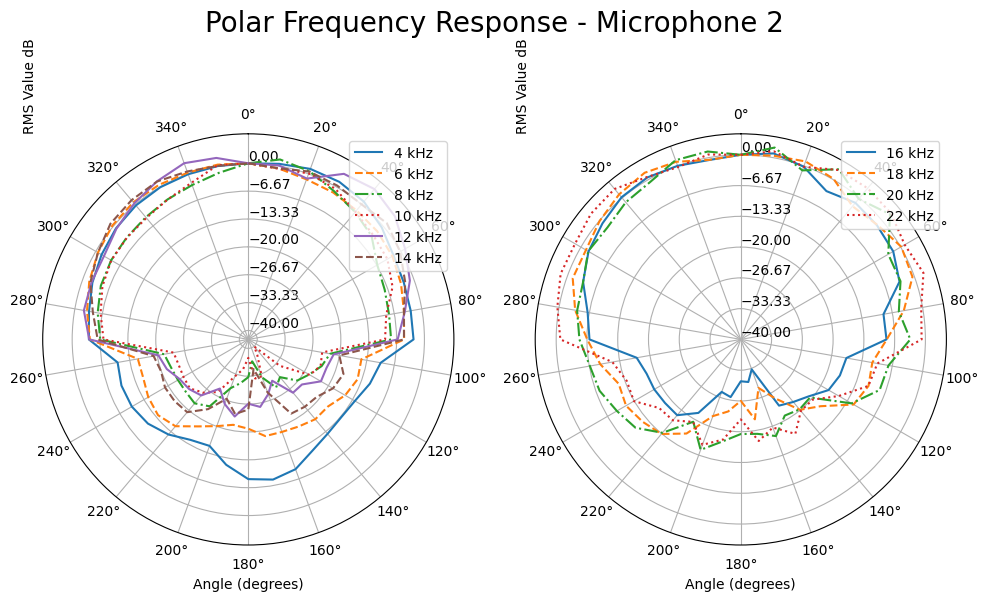

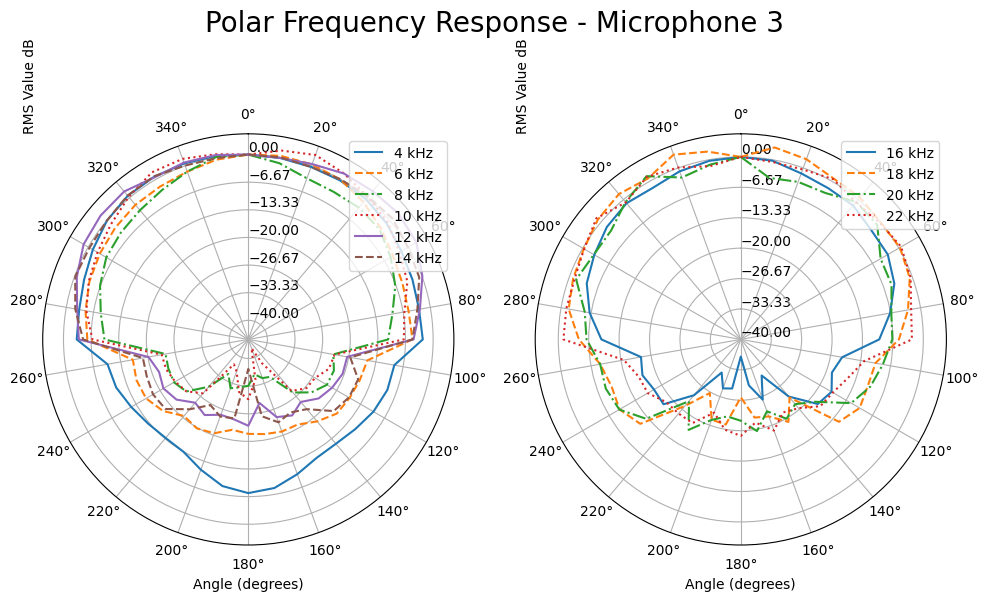

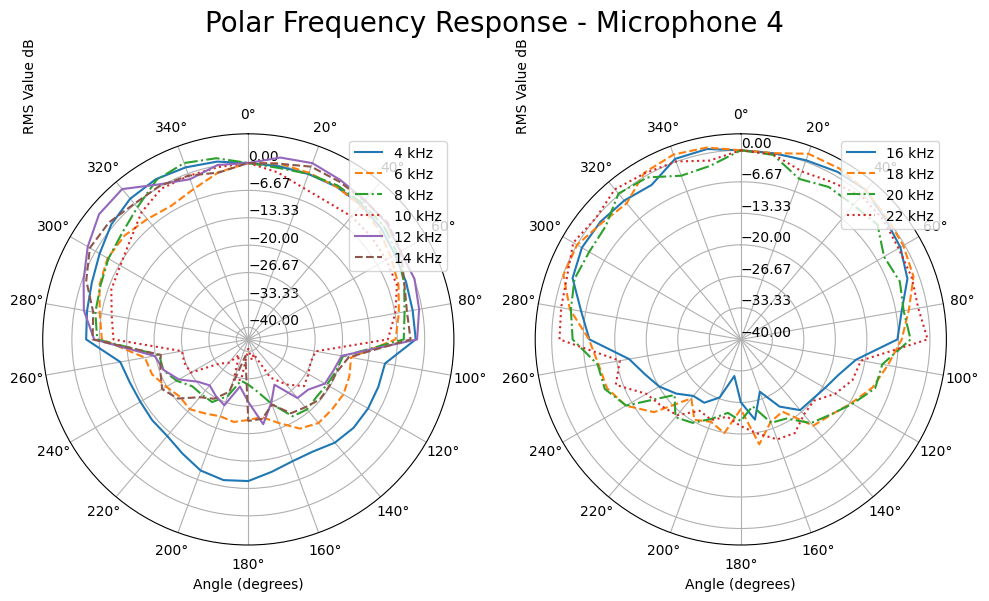

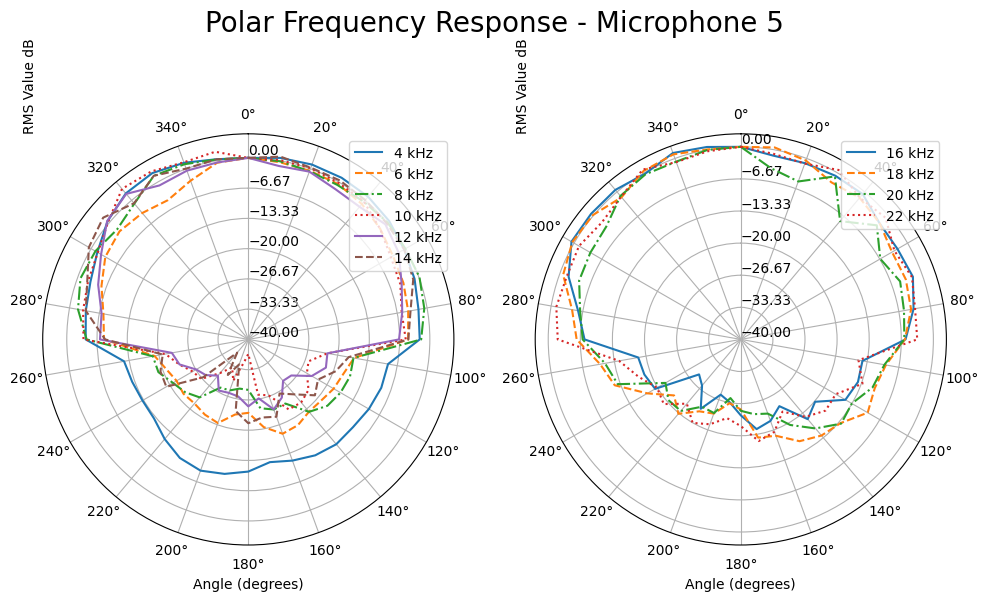

In [48]:
import soundfile as sf
from scipy import fft
# Central frequencies of the bands
central_freq = np.array([4e3, 6e3, 8e3, 10e3, 12e3, 14e3, 16e3, 18e3, 20e3, 22e3])
BW = 1e3  # Bandwidth of the bands
linestyles = ["-", "--", "-.", ":", "-", "--"]  # Line styles for the plot
# Group central frequencies into 3 sets of 6 bands each
num_bands_per_plot = 6
central_freq_sets = [central_freq[i * num_bands_per_plot:(i + 1) * num_bands_per_plot] for i in range(3)]
# Number of microphones
num_mics = num_channels
# Plot for each microphone
for mic in range(1, num_mics + 1):
    files = grouped_files[mic]
    angles = [int(file.split('_')[0]) for file in files]  # Extract angles from filenames
    # Create a figure with 3 polar subplots
    fig, axes = plt.subplots(1, 2, subplot_kw={"projection": "polar"}, figsize=(10, 6))
    plt.suptitle(f"Polar Frequency Response - Microphone {mic}", fontsize=20)
    for ax_idx, ax in enumerate(axes):
        ii = 0
        for fc in central_freq_sets[ax_idx]:
        
            audio_patt = []
            for file in files:
                file_path = os.path.join(DIR_first_sweep, file)
                audio, fs = sf.read(file_path)
                # Compute FFT
                audio_freq = fft.fft(audio, n=2048)
                audio_freq = audio_freq[:1024]
                freqs = fft.fftfreq(2048, 1 / fs)[:1024]
                # Compute mean radiance in the band
                band_mean = np.mean(np.abs(audio_freq[(freqs > fc - BW) & (freqs < fc + BW)]))
                audio_patt.append(band_mean)
            # Normalize and plot
            audio_patt_norm = audio_patt / audio_patt[0] # Normalize the radiance
            audio_patt_norm_dB = 20 * np.log10(audio_patt_norm) # Convert the radiance to dB
        
            if fc >= 10e3:
                label = f"{fc / 1e3:.0f} kHz"
            else:
                label = f"{fc / 1e3:.0f} kHz"
        
            ax.plot(np.deg2rad(angles), audio_patt_norm_dB, label=label, linestyle=linestyles[ii])
            ii +=1
        # Configure polar plot
        ax.legend(loc="upper right")
        ax.set_theta_offset(np.pi / 2)
        ax.set_theta_zero_location("N")  # Set 0 degrees to North
        ax.set_theta_direction(-1)  # Set clockwise direction
        ax.set_xticks(np.linspace(0, 2 * np.pi, 18, endpoint=False))  # Set angle ticks
        ax.set_yticks(np.linspace(-40, 0, 7))
        ax.set_xlabel("Angle (degrees)")
        ax.set_ylabel("RMS Value dB", position=(0, 1), ha='left')
        ax.set_rlabel_position(0)
    plt.tight_layout()
    plt.show()

# Final notes

